# Exploratory Data Analysis of Bhopal Weather Data


## Libraries and data paths

In [2]:

# data importing & processing
import os
import pandas as pd
from datetime import date

# dash & ploting
import dash
from dash import dcc, html, callback, Output, Input
from dash.dependencies import Input, Output
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objs as go

**This note book will contain the EDA of both daily data & hourly data, thus we find out the paths of these files**

In [3]:
# declare paths
#path_notebooks=os.path.abspath(os.path.join(os.getcwd(), os.pardir))
#path_root = os.path.abspath(os.path.join(path_notebooks, os.pardir))
#path_data1 = os.path.join(path_root, 'datafiles/datamarts', 'DailyData_1970_2023.csv')
#path_data2 = os.path.join(path_root, 'datafiles/datamarts', 'HourlyData_2013_2023.csv')

### **Analyzing the Daily Data**

In [5]:
# put the path of the daily data file in path_data
path_data = ''
df_eda = pd.read_csv(path_data)
df_eda.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19663 entries, 0 to 19662
Data columns (total 6 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   Unnamed: 0                  19663 non-null  int64         
 1   date                        19663 non-null  datetime64[ns]
 2   temperature_2m_mean         19663 non-null  float64       
 3   precipitation_sum           19663 non-null  float64       
 4   wind_speed_10m_max          19663 non-null  float64       
 5   et0_fao_evapotranspiration  19663 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(1)
memory usage: 921.8 KB


In [6]:
df_eda.describe()

,Unnamed: 0,temperature_2m_mean,precipitation_sum,wind_speed_10m_max,et0_fao_evapotranspiration
count,19663.000000,19663.000000,19663.000000,19663.000000,19663.000000
mean,9831.000000,25.215286,3.023216,14.458119,4.960580
std,5676.363507,5.210867,10.506666,4.482136,2.249914
min,0.000000,11.135249,0.000000,4.510787,0.345099
25%,4915.500000,21.631418,0.000000,10.799999,3.497038
50%,9831.000000,25.141836,0.000000,13.627795,4.405712
75%,14746.500000,28.260415,0.900000,17.581125,6.433641
max,19662.000000,38.462666,283.600000,41.982853,12.790140


In [7]:
df_eda.shape

(19663, 6)

In [8]:
df_eda.head()

,Unnamed: 0,date,temperature_2m_mean,precipitation_sum,wind_speed_10m_max,et0_fao_evapotranspiration
0,0,1969-12-31 18:30:00,16.606419,0.0,10.514218,3.774898
1,1,1970-01-01 18:30:00,16.968916,0.0,10.440000,3.390604
2,2,1970-01-02 18:30:00,17.596000,0.0,9.726665,3.686964
3,3,1970-01-03 18:30:00,17.629333,0.0,9.387651,3.774567
4,4,1970-01-04 18:30:00,17.293919,0.0,13.358861,4.017039


**Checking for Null Values**

In [10]:
df_eda.isnull().sum()

Unnamed: 0                    0
date                          0
temperature_2m_mean           0
precipitation_sum             0
wind_speed_10m_max            0
et0_fao_evapotranspiration    0
dtype: int64

In [70]:
df_eda_copy = df_eda.copy()
#df_eda_copy2['date'] = pd.to_datetime(df_eda_copy2['date'])
df_eda_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19663 entries, 0 to 19662
Data columns (total 6 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   Unnamed: 0                  19663 non-null  int64         
 1   date                        19663 non-null  datetime64[ns]
 2   temperature_2m_mean         19663 non-null  float64       
 3   precipitation_sum           19663 non-null  float64       
 4   wind_speed_10m_max          19663 non-null  float64       
 5   et0_fao_evapotranspiration  19663 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(1)
memory usage: 921.8 KB


In [12]:
df_eda_copy.drop(['Unnamed: 0'],axis=1,inplace=True)
df_eda_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19663 entries, 0 to 19662
Data columns (total 5 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   date                        19663 non-null  datetime64[ns]
 1   temperature_2m_mean         19663 non-null  float64       
 2   precipitation_sum           19663 non-null  float64       
 3   wind_speed_10m_max          19663 non-null  float64       
 4   et0_fao_evapotranspiration  19663 non-null  float64       
dtypes: datetime64[ns](1), float64(4)
memory usage: 768.2 KB


In [13]:
df_eda_copy.head()

,date,temperature_2m_mean,precipitation_sum,wind_speed_10m_max,et0_fao_evapotranspiration
0,1969-12-31 18:30:00,16.606419,0.0,10.514218,3.774898
1,1970-01-01 18:30:00,16.968916,0.0,10.440000,3.390604
2,1970-01-02 18:30:00,17.596000,0.0,9.726665,3.686964
3,1970-01-03 18:30:00,17.629333,0.0,9.387651,3.774567
4,1970-01-04 18:30:00,17.293919,0.0,13.358861,4.017039


**Setting the date column as the index, so that we can easily retrieve the data and plot graphs**

In [14]:
df_eda_copy = df_eda_copy.set_index('date')
df_eda_copy.index

DatetimeIndex(['1969-12-31 18:30:00', '1970-01-01 18:30:00',
               '1970-01-02 18:30:00', '1970-01-03 18:30:00',
               '1970-01-04 18:30:00', '1970-01-05 18:30:00',
               '1970-01-06 18:30:00', '1970-01-07 18:30:00',
               '1970-01-08 18:30:00', '1970-01-09 18:30:00',
               ...
               '2023-10-22 18:30:00', '2023-10-23 18:30:00',
               '2023-10-24 18:30:00', '2023-10-25 18:30:00',
               '2023-10-26 18:30:00', '2023-10-27 18:30:00',
               '2023-10-28 18:30:00', '2023-10-29 18:30:00',
               '2023-10-30 18:30:00', '2023-10-31 18:30:00'],
              dtype='datetime64[ns]', name='date', length=19663, freq=None)

In [15]:
df_eda_copy.head()

,temperature_2m_mean,precipitation_sum,wind_speed_10m_max,et0_fao_evapotranspiration
date,,,,
1969-12-31 18:30:00,16.606419,0.0,10.514218,3.774898
1970-01-01 18:30:00,16.968916,0.0,10.440000,3.390604
1970-01-02 18:30:00,17.596000,0.0,9.726665,3.686964
1970-01-03 18:30:00,17.629333,0.0,9.387651,3.774567
1970-01-04 18:30:00,17.293919,0.0,13.358861,4.017039


In [16]:
df_eda_copy.loc['2020':'2023'].info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1400 entries, 2020-01-01 18:30:00 to 2023-10-31 18:30:00
Data columns (total 4 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   temperature_2m_mean         1400 non-null   float64
 1   precipitation_sum           1400 non-null   float64
 2   wind_speed_10m_max          1400 non-null   float64
 3   et0_fao_evapotranspiration  1400 non-null   float64
dtypes: float64(4)
memory usage: 54.7 KB


In [17]:
df_eda_copy.loc['2023-01-01':'2023-10-31'].info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 304 entries, 2023-01-01 18:30:00 to 2023-10-31 18:30:00
Data columns (total 4 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   temperature_2m_mean         304 non-null    float64
 1   precipitation_sum           304 non-null    float64
 2   wind_speed_10m_max          304 non-null    float64
 3   et0_fao_evapotranspiration  304 non-null    float64
dtypes: float64(4)
memory usage: 11.9 KB


**Plotting a scatter matrix to see the interdependcy of the variables***

In [18]:
fig = px.scatter_matrix(df_eda_copy, 
                        dimensions=["precipitation_sum", "temperature_2m_mean", "wind_speed_10m_max","et0_fao_evapotranspiration"],
                        title="Scatter Plot of the Parameters",
                        labels={"precipitation_sum":"PPT","temperature_2m_mean":"Temp","wind_speed_10m_max":"Wind speed","et0_fao_evapotranspiration":"ET"},
                        template='plotly_dark')
#fig.update_layout(font_color="white", bargap=0.2,paper_bgcolor="rgba(0,0,0,0)", plot_bgcolor="rgba(0,0,0,0)" )
fig.show()

In [19]:
df_eda_copy[["precipitation_sum", "temperature_2m_mean", "wind_speed_10m_max","et0_fao_evapotranspiration"]].corr(method="pearson")

,precipitation_sum,temperature_2m_mean,wind_speed_10m_max,et0_fao_evapotranspiration
precipitation_sum,1.000000,-0.036029,0.243353,-0.363699
temperature_2m_mean,-0.036029,1.000000,0.441504,0.724326
wind_speed_10m_max,0.243353,0.441504,1.000000,0.254610
et0_fao_evapotranspiration,-0.363699,0.724326,0.254610,1.000000


**From the above table and the correlation matrix we can see that the parameters: wind speed & the evapotranspiration have a weak positive & negative correlation with the total precipitation respectively**

#### Precipitation Trend Over the time period 1970-2023

In [20]:
# line chart 
fig = px.line(df_eda_copy, x= df_eda_copy.index, y="precipitation_sum",   title='Precipitation Trend')
fig.update_layout(font_color="white", bargap=0.2,yaxis_title="Amount of precipitation (mm)",xaxis_title="Time" , paper_bgcolor="rgba(0,0,0,0)", plot_bgcolor="rgba(0,0,0,0)" )
fig.show("notebook")

**This is a lot of data and thus it is difficult to ascertain the patterns. Let us take a smaller subset to analyze the inherent patterns in the data.**

Let us see what are the patterns present in the data by considering:

1. Data for a span > 1 year. 
2. Data for a span <= 1 year.

In [21]:
type(df_eda_copy.index)

pandas.core.indexes.datetimes.DatetimeIndex

In [22]:
# taking a slice of 4 years of dataa
start_date = '2010-01-01'
end_date = '2014-01-01'
df_eda_2y = df_eda_copy.loc[start_date:end_date]
index_2y = df_eda_copy.loc[start_date:end_date].index

# taking one year of data
df_eda_1y = df_eda_copy.loc['2016']
index_1y = df_eda_copy.loc['2016'].index

#### Precipitation Trend Over the time period 2010-2014

In [23]:
fig2 = px.line(df_eda_2y,x=index_2y,y='precipitation_sum',
               title='Precipitation Trend over time period 2010-2014')
fig2.update_layout(font_color="white", bargap=0.2,yaxis_title="Amount of precipitation (mm)",xaxis_title="Time" , paper_bgcolor="rgba(0,0,0,0)", plot_bgcolor="rgba(0,0,0,0)" )
fig2.show("notebook")

**From the above plot, we can see that there is a seasonality component in the time series during the months of June to October and the peak value of total precipitation occurs during the months of July or September**

#### Precipitation Trend in the year 2016

In [24]:
fig3 = px.line(df_eda_1y,x=index_1y,y='precipitation_sum',
               title='Precipitation Trend in 2016')
fig3.update_layout(font_color="white", bargap=0.2,yaxis_title="Amount of precipitation (mm)",xaxis_title="Time" , paper_bgcolor="rgba(0,0,0,0)", plot_bgcolor="rgba(0,0,0,0)" )
fig3.show("notebook")

#### **STATIONARITY CHECK**

There are two popular tests to check whether a time series is stationary or not. They are:
1. Kwiatkowski-Phillips-Schmidt-Shin test (KPSS test)
2. Augmented Dickey-Fuller test (ADF Test) 

In this notebook we will be considering the ADF test only.

NOTE: To keep things simple, here we are taking only the p-value into consideration to accept or reject the Null Hypothesis


**ADF Test**:

Null Hypothesis: The data is not stationary

Alternate Hypothesis: The data is stationary

    NOTE: If the p-value<5%, then we reject the null hypothesis


In [39]:
from statsmodels.tsa.stattools import adfuller
adf_results = adfuller(df_eda_copy['precipitation_sum'],autolag='AIC')
df_adf = pd.Series(adf_results[0:4], index=['Test Statistic','p-value','No. of Lags used','No. of data points used'])
print('The ADF results are as follows:')
print(df_adf)
#print()
#print('The critical values are as follows:')
#for key,val in adf_results[4].items():
#    print(key,':',val)

The ADF results are as follows:
Test Statistic            -1.423228e+01
p-value                    1.588964e-26
No. of Lags used           3.500000e+01
No. of data points used    1.962700e+04
dtype: float64


**EXPLANATION OF RESULTS**

**The explanation of the results from the above two tests are follows:**
    
In the ADF test, as the p-value is less than 0.05,

    Thus we can conclude that the time series of precipitation variable is Stationary

#### **CHECKING THE AUTOCORRELATION**

**Lag Plots**

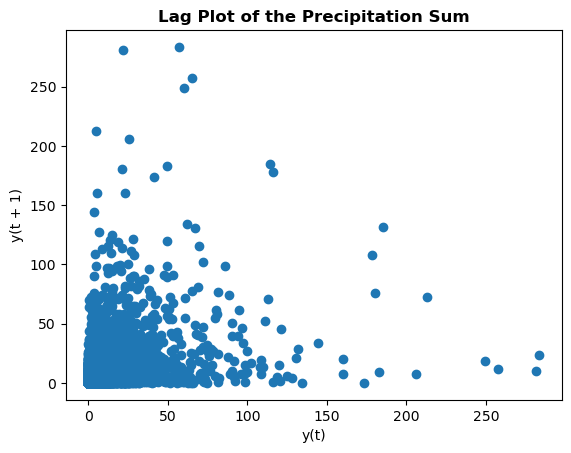

In [27]:
pd.plotting.lag_plot(df_eda_copy['precipitation_sum'],lag=1)
plt.title('Lag Plot of the Precipitation Sum',fontweight='bold')
plt.show()

1. **In general, there exists no clear pattern in this plot which is an indicator of the weak autocorrelation for the precipitation parameter.**
2. **There exists some outliers as well.**
3. **From this plot, we can see that there exists dependability or correlation up to certain extent between the variable value at the present moment and its values at only some of the lags behind the current time step.**

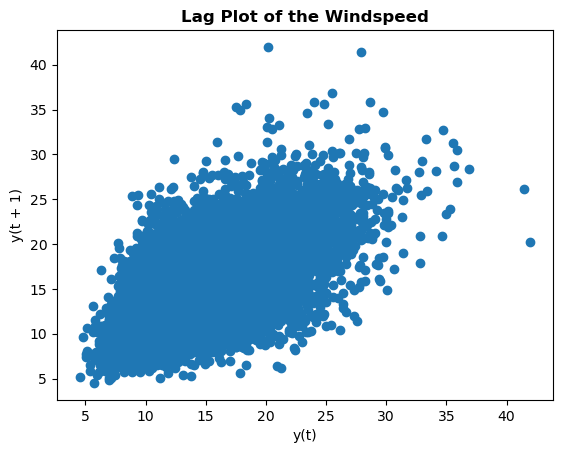

In [28]:
pd.plotting.lag_plot(df_eda_copy['wind_speed_10m_max'],lag=1)
plt.title('Lag Plot of the Windspeed',fontweight='bold')
plt.show()

**There is a moderate autocorrelation in case of the windspeed parameter**

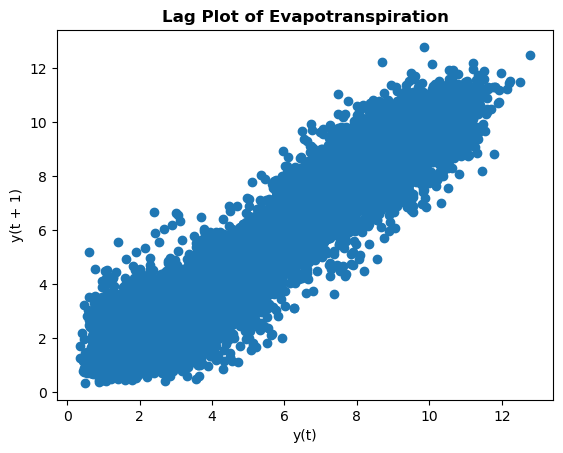

In [29]:
pd.plotting.lag_plot(df_eda_copy['et0_fao_evapotranspiration'],lag=1)
plt.title('Lag Plot of Evapotranspiration',fontweight='bold')
plt.show()

**This plot shows that there is a moderately strong autocorrelation in case of the evapotranspiration parameter**

For more info regarding lag plots, refer this article: https://www.geeksforgeeks.org/lag-plots/

**Autocorrelation Plots**

<Figure size 1200x300 with 0 Axes>

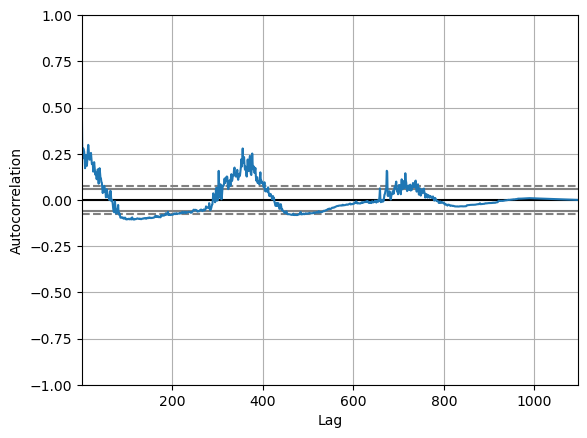

<Figure size 1200x300 with 0 Axes>

In [30]:
#import pandas as pd
pd.plotting.autocorrelation_plot(df_eda_copy["2010":"2012"]["precipitation_sum"])
plt.figure(figsize=(12,3))

**Since the lags are too much, making it a bit difficult to deduce valuable information, we can reducing the lag by resampling the data**

In [31]:
resampled_ppt = df_eda_copy["2010":"2012"]["precipitation_sum"].resample('M').mean()
resampled_ppt[:10]

date
2010-01-31     0.048387
2010-02-28     0.207143
2010-03-31     0.006452
2010-04-30     0.000000
2010-05-31     0.090323
2010-06-30     3.120000
2010-07-31    10.058065
2010-08-31     9.587097
2010-09-30    10.383333
2010-10-31     0.461290
Freq: M, Name: precipitation_sum, dtype: float64

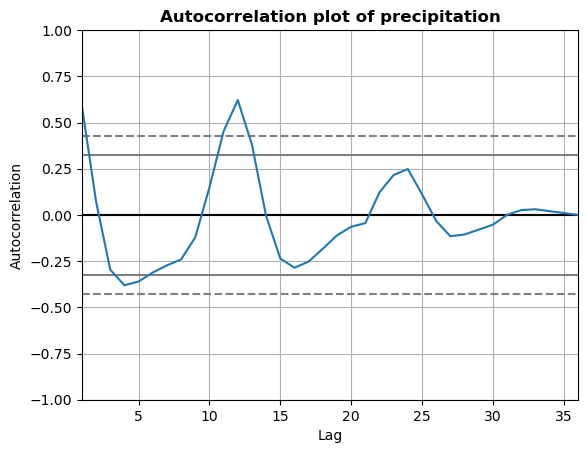

<Figure size 1200x300 with 0 Axes>

In [32]:
pd.plotting.autocorrelation_plot(resampled_ppt)
plt.title("Autocorrelation plot of precipitation",fontweight='bold')
plt.figure(figsize=(12,3))
plt.show()

**The solid lines indicate 90% confidence intervals, whereas the dotted lines indicate 95% confidence intervals**. From the inital part of the graph we can conclude that within one year or so, the autocorrelation between the precipitation and its lags are strong. But later this relationship starts to decrease. This is also apparent from the lag plot of the same variable as shown above. 

The peaks at 12 & 24 months indicate that there is a seasonality component 

In [33]:
resampled_speed = df_eda_copy["2010":"2012"]["wind_speed_10m_max"].resample('M').mean()
resampled_speed[:10]

date
2010-01-31    10.487941
2010-02-28    12.043430
2010-03-31    14.697055
2010-04-30    15.690682
2010-05-31    19.206796
2010-06-30    17.784014
2010-07-31    14.021084
2010-08-31    12.491406
2010-09-30    12.481903
2010-10-31    11.062163
Freq: M, Name: wind_speed_10m_max, dtype: float64

<Figure size 1200x300 with 0 Axes>

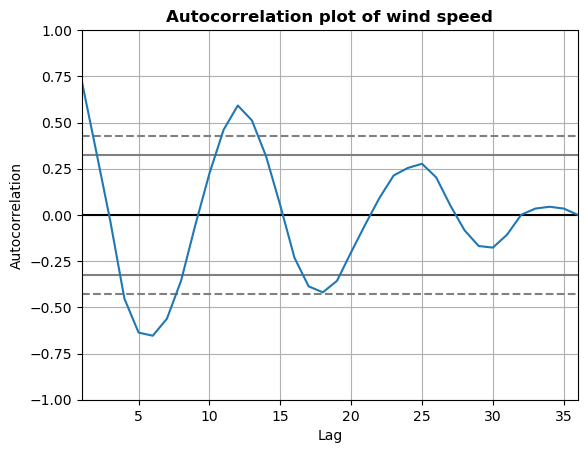

<Figure size 1200x300 with 0 Axes>

In [34]:
plt.title("Autocorrelation plot of wind speed",fontweight='bold')
pd.plotting.autocorrelation_plot(resampled_speed)
plt.figure(figsize=(12,3))

**From this graph we can conclude that even after one year till two years, the autocorrelation between the wind speed and its lags are strong and later this decreases**. This moderately strong autocorrelation can also be seen in the lag plot of the same variable.

In [35]:
resampled_ET = df_eda_copy["2010":"2012"]["et0_fao_evapotranspiration"].resample('M').mean()
resampled_ET[:10]

date
2010-01-31    3.526371
2010-02-28    4.557652
2010-03-31    7.090816
2010-04-30    8.677853
2010-05-31    9.701305
2010-06-30    7.008983
2010-07-31    3.172515
2010-08-31    2.678617
2010-09-30    3.350636
2010-10-31    4.373391
Freq: M, Name: et0_fao_evapotranspiration, dtype: float64

<Figure size 1200x300 with 0 Axes>

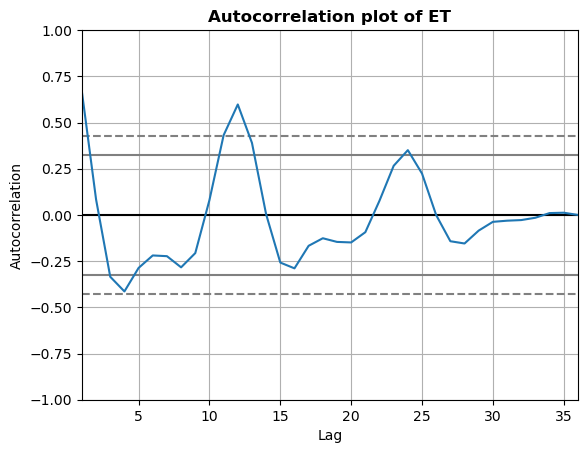

<Figure size 1200x300 with 0 Axes>

In [36]:
plt.title("Autocorrelation plot of ET",fontweight='bold')
pd.plotting.autocorrelation_plot(resampled_ET)
plt.figure(figsize=(12,3))

**In this plot, indicates a moderately strong autocorrelation between the precipitation and its lags, which is also visible in the lag plot**.

### **Analyzing the Hourly Data**

Almost all the EDA steps are the same as in case of the EDA of daily data

In [40]:
# put the path of the hourly data file in path_data2
path_data2 = ''
df_eda_h = pd.read_csv(path_data2)
df_eda_h.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94968 entries, 0 to 94967
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   Unnamed: 0                  94968 non-null  int64         
 1   date                        94968 non-null  datetime64[ns]
 2   temperature_2m              94968 non-null  float64       
 3   relative_humidity_2m        94968 non-null  float64       
 4   precipitation               94968 non-null  float64       
 5   surface_pressure            94968 non-null  float64       
 6   et0_fao_evapotranspiration  94968 non-null  float64       
 7   vapour_pressure_deficit     94968 non-null  float64       
 8   wind_speed_10m              94968 non-null  float64       
dtypes: datetime64[ns](1), float64(7), int64(1)
memory usage: 6.5 MB


In [41]:
df_eda_h.describe()

,Unnamed: 0,temperature_2m,relative_humidity_2m,precipitation,surface_pressure,et0_fao_evapotranspiration,vapour_pressure_deficit,wind_speed_10m
count,94968.000000,94968.000000,94968.000000,94968.000000,94968.000000,94968.000000,94968.000000,94968.000000
mean,47483.500000,25.150310,57.883381,0.159245,953.402962,0.198524,1.640347,9.972006
std,27415.044519,6.509931,25.705867,0.821959,5.128611,0.223771,1.533928,4.461927
min,0.000000,5.041500,5.588035,0.000000,936.043200,0.000000,0.000000,0.000000
25%,23741.750000,21.491499,35.164561,0.000000,949.300198,0.024419,0.473059,6.924738
50%,47483.500000,25.058500,59.249227,0.000000,953.681520,0.096774,1.123419,9.114471
75%,71225.250000,29.041500,81.095647,0.000000,957.601335,0.333417,2.379075,12.481153
max,94967.000000,45.208500,100.000000,33.800000,967.100460,1.028513,8.863323,41.982853


In [42]:
df_eda_h.shape

(94968, 9)

In [43]:
df_eda_h.head()

,Unnamed: 0,date,temperature_2m,relative_humidity_2m,precipitation,surface_pressure,et0_fao_evapotranspiration,vapour_pressure_deficit,wind_speed_10m
0,0,2012-12-31 18:30:00,16.9085,77.043526,0.0,954.29920,0.009078,0.442558,7.636753
1,1,2012-12-31 19:30:00,16.3585,78.487595,0.0,954.10004,0.005114,0.400501,6.989936
2,2,2012-12-31 20:30:00,16.0085,79.212425,0.0,953.75020,0.002433,0.378480,6.409617
3,3,2012-12-31 21:30:00,15.8085,79.183685,0.0,953.99493,0.003766,0.374201,6.877789
4,4,2012-12-31 22:30:00,15.5585,79.933200,0.0,954.04114,0.002870,0.355010,6.877789


In [44]:
df_eda_h.tail()

,Unnamed: 0,date,temperature_2m,relative_humidity_2m,precipitation,surface_pressure,et0_fao_evapotranspiration,vapour_pressure_deficit,wind_speed_10m
94963,94963,2023-11-01 13:30:00,23.3415,57.174206,0.0,958.80524,0.045588,1.228319,8.373386
94964,94964,2023-11-01 14:30:00,22.3915,62.950500,0.0,959.38630,0.031807,1.003271,7.653705
94965,94965,2023-11-01 15:30:00,24.0915,54.122696,0.0,959.79250,0.037176,1.376514,6.489992
94966,94966,2023-11-01 16:30:00,23.0415,59.358875,0.0,959.41150,0.000000,1.144729,1.484318
94967,94967,2023-11-01 17:30:00,21.0415,67.272270,0.0,958.85260,0.024357,0.816181,7.594207


**Checking for Null values**

In [45]:
df_eda_h.isnull().sum()

Unnamed: 0                    0
date                          0
temperature_2m                0
relative_humidity_2m          0
precipitation                 0
surface_pressure              0
et0_fao_evapotranspiration    0
vapour_pressure_deficit       0
wind_speed_10m                0
dtype: int64

**Converting the date column to datetime from object type**

In [46]:
df_eda_copy2 = df_eda_h.copy()
#df_eda_copy2['date'] = pd.to_datetime(df_eda_copy2['date'])
df_eda_copy2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94968 entries, 0 to 94967
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   Unnamed: 0                  94968 non-null  int64         
 1   date                        94968 non-null  datetime64[ns]
 2   temperature_2m              94968 non-null  float64       
 3   relative_humidity_2m        94968 non-null  float64       
 4   precipitation               94968 non-null  float64       
 5   surface_pressure            94968 non-null  float64       
 6   et0_fao_evapotranspiration  94968 non-null  float64       
 7   vapour_pressure_deficit     94968 non-null  float64       
 8   wind_speed_10m              94968 non-null  float64       
dtypes: datetime64[ns](1), float64(7), int64(1)
memory usage: 6.5 MB


In [47]:
df_eda_copy2.drop(['Unnamed: 0'],axis=1,inplace=True)
df_eda_copy2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94968 entries, 0 to 94967
Data columns (total 8 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   date                        94968 non-null  datetime64[ns]
 1   temperature_2m              94968 non-null  float64       
 2   relative_humidity_2m        94968 non-null  float64       
 3   precipitation               94968 non-null  float64       
 4   surface_pressure            94968 non-null  float64       
 5   et0_fao_evapotranspiration  94968 non-null  float64       
 6   vapour_pressure_deficit     94968 non-null  float64       
 7   wind_speed_10m              94968 non-null  float64       
dtypes: datetime64[ns](1), float64(7)
memory usage: 5.8 MB


In [48]:
df_eda_copy2.head()

,date,temperature_2m,relative_humidity_2m,precipitation,surface_pressure,et0_fao_evapotranspiration,vapour_pressure_deficit,wind_speed_10m
0,2012-12-31 18:30:00,16.9085,77.043526,0.0,954.29920,0.009078,0.442558,7.636753
1,2012-12-31 19:30:00,16.3585,78.487595,0.0,954.10004,0.005114,0.400501,6.989936
2,2012-12-31 20:30:00,16.0085,79.212425,0.0,953.75020,0.002433,0.378480,6.409617
3,2012-12-31 21:30:00,15.8085,79.183685,0.0,953.99493,0.003766,0.374201,6.877789
4,2012-12-31 22:30:00,15.5585,79.933200,0.0,954.04114,0.002870,0.355010,6.877789


**Setting date column as the index for this dataframe**

In [49]:
df_eda_copy2 = df_eda_copy2.set_index('date')
df_eda_copy2.index

DatetimeIndex(['2012-12-31 18:30:00', '2012-12-31 19:30:00',
               '2012-12-31 20:30:00', '2012-12-31 21:30:00',
               '2012-12-31 22:30:00', '2012-12-31 23:30:00',
               '2013-01-01 00:30:00', '2013-01-01 01:30:00',
               '2013-01-01 02:30:00', '2013-01-01 03:30:00',
               ...
               '2023-11-01 08:30:00', '2023-11-01 09:30:00',
               '2023-11-01 10:30:00', '2023-11-01 11:30:00',
               '2023-11-01 12:30:00', '2023-11-01 13:30:00',
               '2023-11-01 14:30:00', '2023-11-01 15:30:00',
               '2023-11-01 16:30:00', '2023-11-01 17:30:00'],
              dtype='datetime64[ns]', name='date', length=94968, freq=None)

In [50]:
df_eda_copy2.head()

,temperature_2m,relative_humidity_2m,precipitation,surface_pressure,et0_fao_evapotranspiration,vapour_pressure_deficit,wind_speed_10m
date,,,,,,,
2012-12-31 18:30:00,16.9085,77.043526,0.0,954.29920,0.009078,0.442558,7.636753
2012-12-31 19:30:00,16.3585,78.487595,0.0,954.10004,0.005114,0.400501,6.989936
2012-12-31 20:30:00,16.0085,79.212425,0.0,953.75020,0.002433,0.378480,6.409617
2012-12-31 21:30:00,15.8085,79.183685,0.0,953.99493,0.003766,0.374201,6.877789
2012-12-31 22:30:00,15.5585,79.933200,0.0,954.04114,0.002870,0.355010,6.877789


In [51]:
df_eda_copy2.loc['2012-12-31 18:30:00':'2012-12-31 21:30:00']

,temperature_2m,relative_humidity_2m,precipitation,surface_pressure,et0_fao_evapotranspiration,vapour_pressure_deficit,wind_speed_10m
date,,,,,,,
2012-12-31 18:30:00,16.9085,77.043526,0.0,954.29920,0.009078,0.442558,7.636753
2012-12-31 19:30:00,16.3585,78.487595,0.0,954.10004,0.005114,0.400501,6.989936
2012-12-31 20:30:00,16.0085,79.212425,0.0,953.75020,0.002433,0.378480,6.409617
2012-12-31 21:30:00,15.8085,79.183685,0.0,953.99493,0.003766,0.374201,6.877789


**Plotting the Scatter matrix**

In [52]:
fig = px.scatter_matrix(df_eda_copy2, 
                        dimensions=["precipitation", "temperature_2m", "relative_humidity_2m",
                                    "surface_pressure","et0_fao_evapotranspiration","vapour_pressure_deficit","wind_speed_10m"],
                        title="Scatter Plot of the Parameters",
                        labels={"precipitation":"PPT","temperature_2m":"Temp","wind_speed_10m":"Wind Speed",
                                "et0_fao_evapotranspiration":"ET","relative_humidity_2m":"RH","surface_pressure":"Pressure",
                                "vapour_pressure_deficit":"Vap. Press."},
                        template='plotly_dark',height=800,width=1300)
fig.show()

In [53]:
df_eda_copy2[["precipitation", "temperature_2m", "relative_humidity_2m",
             "surface_pressure","et0_fao_evapotranspiration","vapour_pressure_deficit","wind_speed_10m"]].corr(method="pearson")

,precipitation,temperature_2m,relative_humidity_2m,surface_pressure,et0_fao_evapotranspiration,vapour_pressure_deficit,wind_speed_10m
precipitation,1.000000,-0.016344,0.238341,-0.250686,-0.089662,-0.161719,0.152495
temperature_2m,-0.016344,1.000000,-0.553000,-0.439489,0.680855,0.793571,0.228217
relative_humidity_2m,0.238341,-0.553000,1.000000,-0.255508,-0.622226,-0.881477,-0.006079
surface_pressure,-0.250686,-0.439489,-0.255508,1.000000,0.056709,-0.021657,-0.386037
et0_fao_evapotranspiration,-0.089662,0.680855,-0.622226,0.056709,1.000000,0.734953,0.179586
vapour_pressure_deficit,-0.161719,0.793571,-0.881477,-0.021657,0.734953,1.000000,0.123049
wind_speed_10m,0.152495,0.228217,-0.006079,-0.386037,0.179586,0.123049,1.000000


**From the above table and the correlation matrix we can see that the parameters: Relative Humidity, wind speed have a moderate positive correlation with precipitation, whereas the parameters: surface pressure, vapor pressure have a moderate negative correlation with the precipitation**

### Precipitation Trend Over the time period 2013-2023

In [54]:
# line chart 
fig = px.line(df_eda_copy2, x= df_eda_copy2.index, y="precipitation", title='Precipitation Trend')
fig.update_layout(font_color="white", bargap=0.2,yaxis_title="Amount of precipitation (mm)",xaxis_title="Time" , paper_bgcolor="rgba(0,0,0,0)", plot_bgcolor="rgba(0,0,0,0)" )
fig.show("notebook")

**It can be seen that the time series has seasonality, as the spike in the time series exists during the span of June to October**

**Looking at the trends by narrowing down the time period**

Let us see what are the patterns present in the data by considering:

1. Data for a span > 1 year. 
2. Data for a span <= 1 year.

In [55]:
# taking a slice of 3 years of data
start_date = '2013-01-01'
end_date = '2016-01-01'
df_2y = df_eda_copy2.loc[start_date:end_date]
ind_2y = df_2y.index

# taking one year of data
df_1y = df_eda_copy2.loc['2017-01-01':'2018-01-01']
ind_1y = df_1y.index

### Precipitation Trend Over the time period 2013-2016

In [56]:
fig2 = px.line(df_2y,x=ind_2y,y='precipitation',
               title='Precipitation Trend over time period 2013-2016')
fig2.update_layout(font_color="white", bargap=0.2,yaxis_title="Amount of precipitation (mm)",xaxis_title="Time" , paper_bgcolor="rgba(0,0,0,0)", plot_bgcolor="rgba(0,0,0,0)" )
fig2.show("notebook")

**From the above plot, we can see that the peak value of precipitation occurs during the months of July or September**

### Precipitation Trend over the years 2017-18

In [57]:
fig3 = px.line(df_1y,x=ind_1y,y='precipitation',
               title='Precipitation Trend over the years 2017-18')
fig3.update_layout(font_color="white", bargap=0.2,yaxis_title="Amount of precipitation (mm)",xaxis_title="Time" , paper_bgcolor="rgba(0,0,0,0)", plot_bgcolor="rgba(0,0,0,0)" )
fig3.show("notebook")

#### **STATIONARITY CHECK**


**ADF Test**:

Null Hypothesis: The data is not stationary

Alternate Hypothesis: The data is stationary

        NOTE: If the p-value<5% then we reject the null hypothesis


In [69]:
from statsmodels.tsa.stattools import adfuller
adf_results = adfuller(df_eda_copy2['precipitation'],autolag='AIC')
df_adf = pd.Series(adf_results[0:4], index=['Test Statistic','p-value','No. of Lags used','No. of data points used'])
print('The ADF results are as follows:')
print(df_adf)
#print()
#print('The critical values are as follows:')
#for key,val in adf_results[4].items():
#    print(key,':',val)

The ADF results are as follows:
Test Statistic               -25.15808
p-value                        0.00000
No. of Lags used              67.00000
No. of data points used    94900.00000
dtype: float64


**RESULTS**
    
From the ADF test, we can conclude that the time series is **Stationary** as the p-value<0.05

#### **CHECKING THE AUTOCORRELATION**

**Lag Plots**

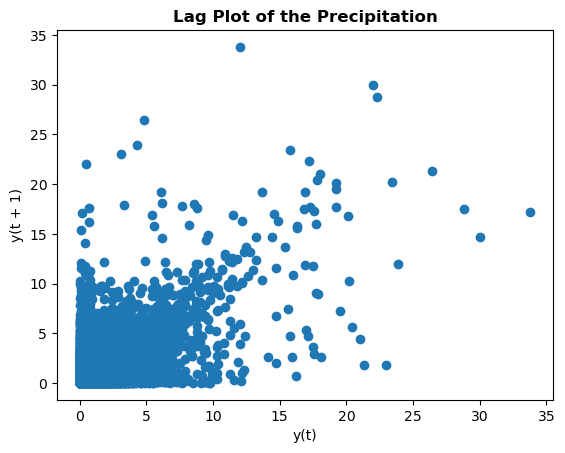

In [60]:
pd.plotting.lag_plot(df_eda_copy2['precipitation'],lag=1)
plt.title('Lag Plot of the Precipitation',fontweight='bold')
plt.show()

1. **There exists a weak linear pattern in this plot which is an indicator of the weak autocorrelation for the precipitation parameter i.e., autocorrelation to only some of the lags.**
2. **There exists some outliers as well.**

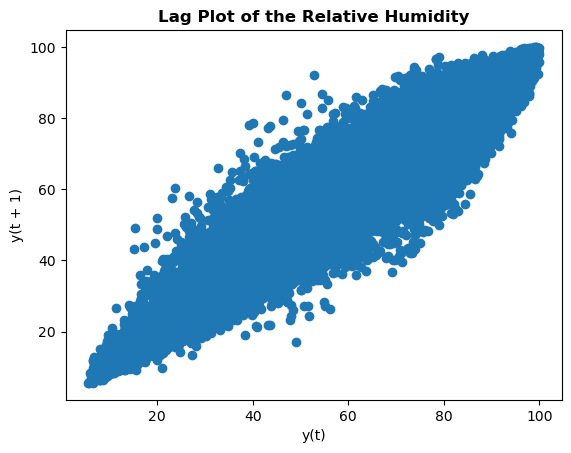

In [61]:
pd.plotting.lag_plot(df_eda_copy2['relative_humidity_2m'],lag=1)
plt.title('Lag Plot of the Relative Humidity',fontweight='bold')
plt.show()

**There is a strong autocorrelation in case of the Relative Humidity**

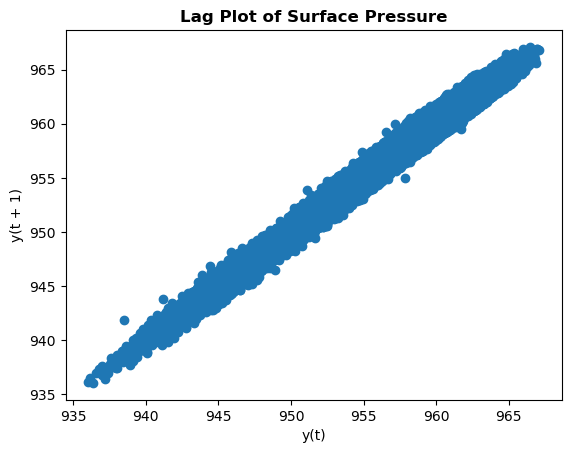

In [62]:
pd.plotting.lag_plot(df_eda_copy2['surface_pressure'],lag=1)
plt.title('Lag Plot of Surface Pressure',fontweight='bold')
plt.show()

**This plot shows that there is a strong autocorrelation in case of the surface pressure parameter**

**Autocorrelation Plots**

In [63]:
resampled_ppt = df_eda_copy2["2013":"2015"]["precipitation"].resample('M').mean()
resampled_ppt[:10]

date
2013-01-31    0.000269
2013-02-28    0.069345
2013-03-31    0.027957
2013-04-30    0.009444
2013-05-31    0.000000
2013-06-30    0.454444
2013-07-31    0.936425
2013-08-31    0.724866
2013-09-30    0.046250
2013-10-31    0.043280
Freq: M, Name: precipitation, dtype: float64

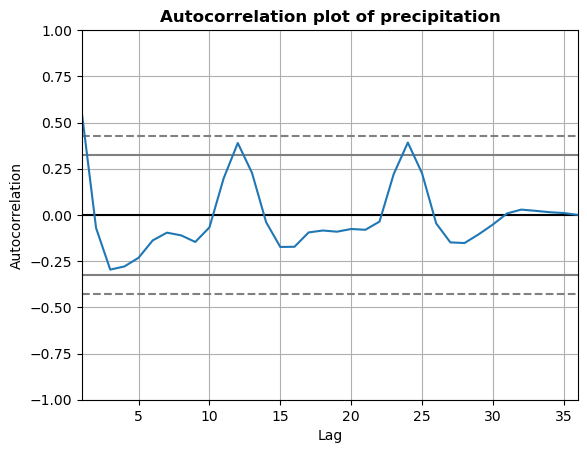

In [64]:
pd.plotting.autocorrelation_plot(resampled_ppt)
plt.title("Autocorrelation plot of precipitation",fontweight='bold')
plt.show()

**As compared to the precipitation sum variable in the daily data, this precipitation variable shows lower autocorrelation strength, since the majority of the plot lies within the confidence limits indicated by the dotted and solid lines.** But the distinction is that in this plot, the curve fades away rather abruptly at the end, thus indicating that there is some autocorrelation between a lot of lag values of precipitation, as also indicated by the lag plot for precipitation, above.

In [65]:
resampled_rh = df_eda_copy2["2013":"2015"]["relative_humidity_2m"].resample('M').mean()
resampled_rh[:10]

date
2013-01-31    51.482163
2013-02-28    62.861547
2013-03-31    38.770764
2013-04-30    29.653712
2013-05-31    23.027059
2013-06-30    73.027667
2013-07-31    91.397401
2013-08-31    89.073051
2013-09-30    74.890749
2013-10-31    68.491209
Freq: M, Name: relative_humidity_2m, dtype: float64

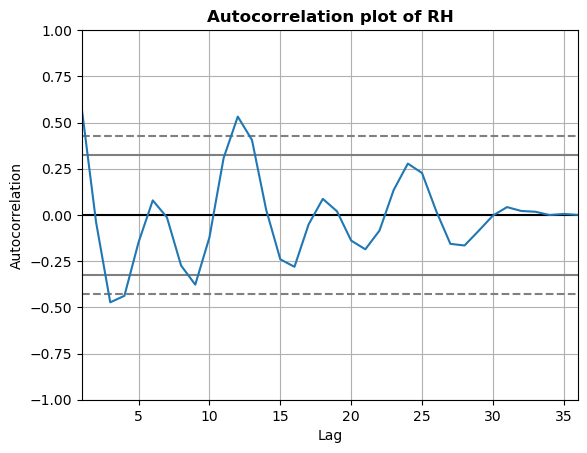

In [66]:
plt.title("Autocorrelation plot of RH",fontweight='bold')
pd.plotting.autocorrelation_plot(resampled_rh)
plt.show()

**We can observe a seasonality component in the above plot for the relative humidity variable and a moderately strong autocorrelation**

In [67]:
resampled_Spr = df_eda_copy2["2013":"2015"]["surface_pressure"].resample('M').mean()
resampled_Spr[:10]

date
2013-01-31    959.078392
2013-02-28    957.897761
2013-03-31    956.094472
2013-04-30    952.559821
2013-05-31    949.101711
2013-06-30    945.999365
2013-07-31    944.779308
2013-08-31    948.003662
2013-09-30    950.566281
2013-10-31    954.247627
Freq: M, Name: surface_pressure, dtype: float64

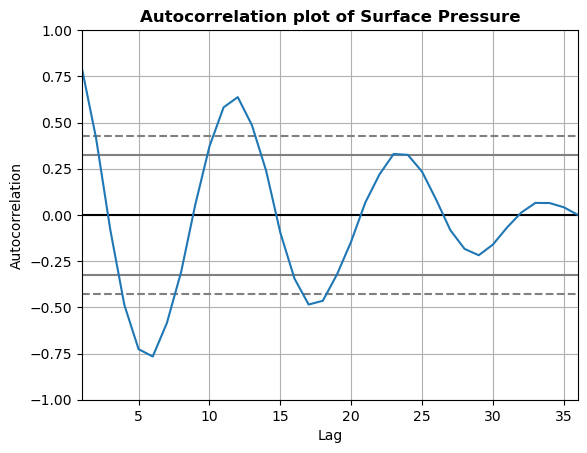

In [68]:
plt.title("Autocorrelation plot of Surface Pressure",fontweight='bold')
pd.plotting.autocorrelation_plot(resampled_Spr)
plt.show()

**We saw in the lag plot that there exists a strong autocorrelation. This fact is also proven here in the autocorrelation plot. We see that the strength of the autocorrelation is high as majority of the curve lies above the 95% confidence intervals.**